In [2]:
import tensorflow as tf
import numpy as np

In [3]:
import tensorflow_datasets as tfds

In [4]:
datos, metadatos = tfds.load('cats_vs_dogs', as_supervised=True, with_info=True)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/23262 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/cats_vs_dogs/incomplete.4GUL2I_4.0.1/cats_vs_dogs-train.tfrecord*...:   0%…

Dataset cats_vs_dogs downloaded and prepared to /root/tensorflow_datasets/cats_vs_dogs/4.0.1. Subsequent calls will reuse this data.


,image,label
0,,1 (dog)
1,,1 (dog)
2,,1 (dog)
3,,0 (cat)
4,,1 (dog)
5,,1 (dog)
6,,0 (cat)
7,,0 (cat)
8,,1 (dog)
9,,1 (dog)

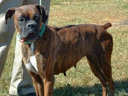
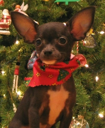
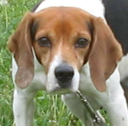
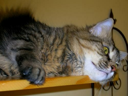
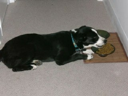
...
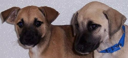
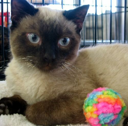
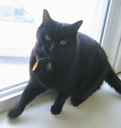
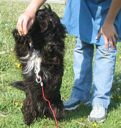
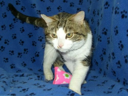

In [5]:
# mostrar los datos de entrenamiento
tfds.as_dataframe(datos['train'].take(25), metadatos)

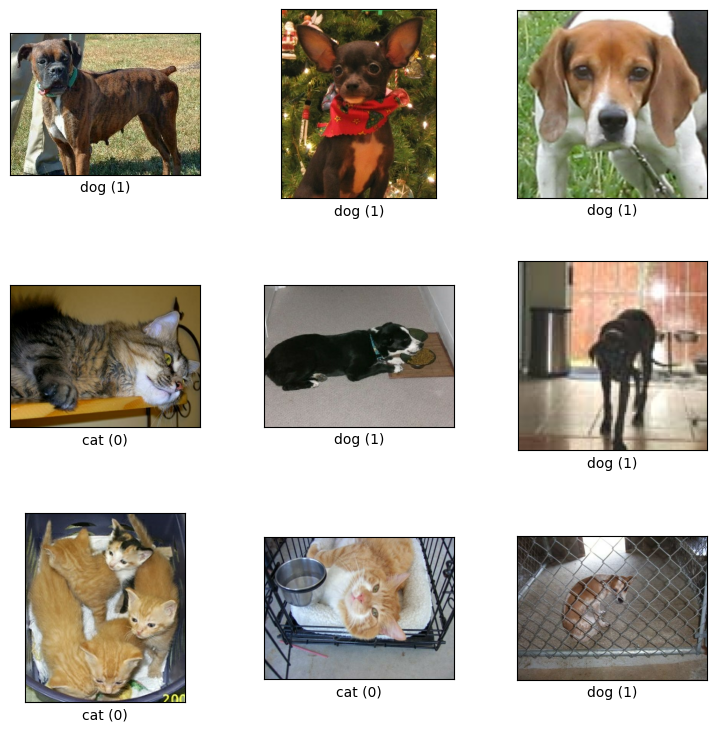

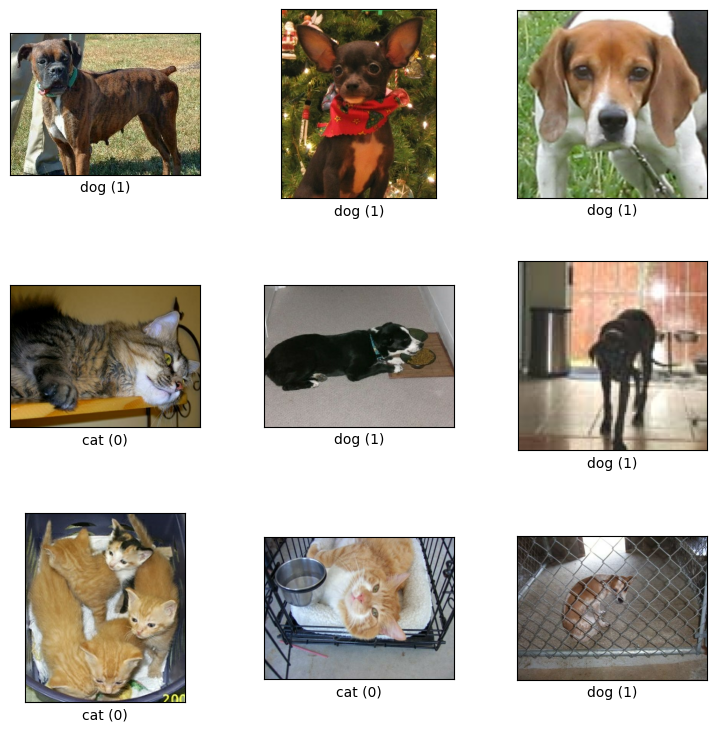

In [6]:
tfds.show_examples(datos['train'], metadatos)

In [7]:
import matplotlib.pyplot as plt
import cv2 # una libreria para el manejo de imagenes
plt.figure(figsize=(20,20))
tamaño_img = 100

<Figure size 2000x2000 with 0 Axes>

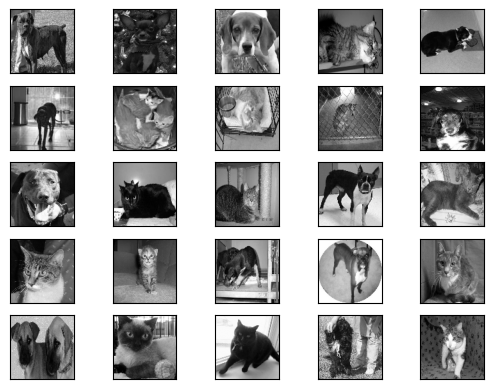

In [8]:
for i, (imagen, etiqueta) in enumerate(datos['train'].take(25)):
    imagen = cv2.resize(imagen.numpy(), (tamaño_img, tamaño_img))
    imagen = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(imagen, cmap= 'gray')

In [9]:
# esta variable contendra todos los pares de los datos (imagen y etiquetas) ya modificados en blanco y negro de 100x100
datos_entrenamiento = []

In [10]:
for i, (imagen, etiqueta) in enumerate(datos['train']): # todos los datos
    imagen = cv2.resize(imagen.numpy(), (tamaño_img, tamaño_img))
    imagen = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
    imagen = imagen.reshape(tamaño_img, tamaño_img, 1)
    datos_entrenamiento.append([imagen, etiqueta])

In [12]:
# ver los datos del primer indice
datos_entrenamiento[0]

[array([[[249],
         [190],
         [105],
         ...,
         [189],
         [196],
         [143]],
 
        [[232],
         [127],
         [ 88],
         ...,
         [187],
         [180],
         [186]],
 
        [[171],
         [ 87],
         [ 83],
         ...,
         [129],
         [158],
         [166]],
 
        ...,
 
        [[113],
         [173],
         [162],
         ...,
         [143],
         [156],
         [119]],
 
        [[140],
         [152],
         [171],
         ...,
         [ 98],
         [155],
         [154]],
 
        [[ 91],
         [109],
         [167],
         ...,
         [ 46],
         [ 51],
         [ 47]]], dtype=uint8),
 <tf.Tensor: shape=(), dtype=int64, numpy=1>]

In [13]:
len(datos_entrenamiento)

23262

In [14]:
# preparamos las variables por separado para los que es imagenes y etiquetas
X = [] # imagenes (pixeles)
y = [] # etiquetas (perro ó gato)

for imagen, etiqueta in datos_entrenamiento:
    X.append(imagen)
    y.append(etiqueta)

In [15]:
X

[array([[[249],
         [190],
         [105],
         ...,
         [189],
         [196],
         [143]],
 
        [[232],
         [127],
         [ 88],
         ...,
         [187],
         [180],
         [186]],
 
        [[171],
         [ 87],
         [ 83],
         ...,
         [129],
         [158],
         [166]],
 
        ...,
 
        [[113],
         [173],
         [162],
         ...,
         [143],
         [156],
         [119]],
 
        [[140],
         [152],
         [171],
         ...,
         [ 98],
         [155],
         [154]],
 
        [[ 91],
         [109],
         [167],
         ...,
         [ 46],
         [ 51],
         [ 47]]], dtype=uint8),
 array([[[149],
         [114],
         [ 93],
         ...,
         [103],
         [ 72],
         [ 81]],
 
        [[127],
         [ 63],
         [ 79],
         ...,
         [131],
         [ 70],
         [ 98]],
 
        [[ 82],
         [ 65],
         [ 58],
         ...,
      

In [16]:
import numpy as np
X = np.array(X).astype(float) / 255
y = np.array(y)

In [17]:
y

array([1, 1, 1, ..., 0, 1, 0])

In [18]:
# ahora creamos los modelos de entrenamiento
modeloDenso = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(input_shape=(100,100,1)),
    tf.keras.layers.Dense(150, activation='relu'),
    tf.keras.layers.Dense(150, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid'),
])
modeloCNN = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(100,100,1)),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(100, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid'),
])

modeloCNN2 = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(100,100,1)),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Dropout(0.5),# permite reducir el sobre ajuste en las capas y las neuronas
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(100, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid'),
])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [19]:
# compilar los modelos
modeloDenso.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
modeloCNN.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
modeloCNN2.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [20]:
from tensorflow.keras.callbacks import TensorBoard

In [21]:
# libnera la memoria ram del equipo
import gc
gc.collect()

0

In [22]:
# empezamos el entrenamiento DENSO
tensorboardDenso = TensorBoard(log_dir = 'logs/denso')
modeloDenso.fit(X, y, batch_size=32, validation_split=0.15, epochs=100, callbacks=[tensorboardDenso])


Epoch 1/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 8s 7ms/step - accuracy: 0.5468 - loss: 0.7833 - val_accuracy: 0.5599 - val_loss: 0.6822
Epoch 2/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.5708 - loss: 0.6778 - val_accuracy: 0.5736 - val_loss: 0.6780
Epoch 3/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.5550 - loss: 0.6773 - val_accuracy: 0.5951 - val_loss: 0.6799
Epoch 4/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.5861 - loss: 0.6700 - val_accuracy: 0.6020 - val_loss: 0.6642
Epoch 5/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.6108 - loss: 0.6591 - val_accuracy: 0.6006 - val_loss: 0.6653
Epoch 6/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.5945 - loss: 0.6629 - val_accuracy: 0.5768 - val_loss: 0.6988
Epoch 7/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.6028 - loss: 0.6613 - val_accuracy: 0.5968 - val_loss: 0.6616
Epoch 8/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.5958 - loss: 0.6605 - val_accu

In [23]:
%load_ext tensorboard

In [24]:
%tensorboard --logdir logs/denso

Output hidden; open in https://colab.research.google.com to view.

In [25]:
# empezamos el entrenamiento CNN
tensorboardCNN = TensorBoard(log_dir = 'logs/denso')
modeloCNN.fit(X, y, batch_size=32, validation_split=0.15, epochs=100, callbacks=[tensorboardCNN])

Epoch 1/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 17s 19ms/step - accuracy: 0.5830 - loss: 0.6591 - val_accuracy: 0.7309 - val_loss: 0.5331
Epoch 2/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step - accuracy: 0.7620 - loss: 0.4963 - val_accuracy: 0.7957 - val_loss: 0.4479
Epoch 3/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - accuracy: 0.8053 - loss: 0.4241 - val_accuracy: 0.8146 - val_loss: 0.4092
Epoch 4/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - accuracy: 0.8402 - loss: 0.3563 - val_accuracy: 0.7894 - val_loss: 0.4449
Epoch 5/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 10s 11ms/step - accuracy: 0.8669 - loss: 0.3079 - val_accuracy: 0.8381 - val_loss: 0.3621
Epoch 6/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 10s 12ms/step - accuracy: 0.8908 - loss: 0.2599 - val_accuracy: 0.8264 - val_loss: 0.3943
Epoch 7/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 7s 12ms/step - accuracy: 0.9160 - loss: 0.2017 - val_accuracy: 0.8450 - val_loss: 0.3577
Epoch 8/100
618/618 ━━━━━━━━━━━━━━━━━━━━ 10s 12ms/step - accuracy: 0.9386 - loss: 0.155

In [26]:
%load_ext tensorboard
%tensorboard --logdir logs/CNN

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# empezamos el entrenamiento CNN2
tensorboardCNN2 = TensorBoard(log_dir = 'logs/denso')
modeloCNN2.fit(X, y, batch_size=32, validation_split=0.15, epochs=100, callbacks=[tensorboardCNN2])

In [40]:
# aumenta los datos al momento de procesar las imagnes
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [42]:
# le damos mas datos a la red para que aprenda a manipular las imagenes y su entrenamiento sea mas preciso
datagen = ImageDataGenerator(
    rotation_range=30,# rota la imagen en funcion de los grados
    width_shift_range=0.2, # mueve la imagen a los lados
    height_shift_range=0.2, # mueve la imagen de arriba a abajo
    shear_range=15,#inlicna la imagen
    zoom_range=[0.7, 1.4], # aumenta la imagen en porcentaje
    horizontal_flip=True,
    vertical_flip=True
)

In [43]:
datagen.fit(X)

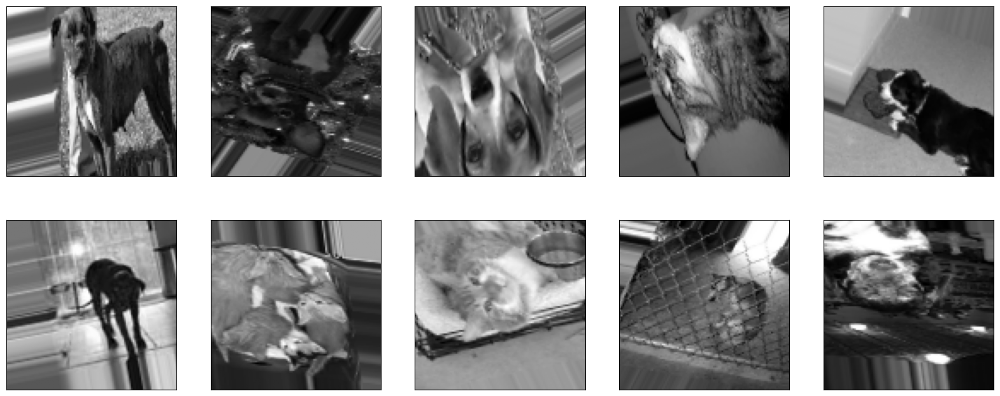

In [44]:
plt.figure(figsize=(20,8))
for imagen, etiqueta in datagen.flow(X, y, batch_size=10, shuffle=False):
  for i in range(10):
    plt.subplot(2,5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(imagen[i].reshape(100, 100), cmap='gray')
  break

In [45]:
#nuevos modelos de redes con aumento de datos
# ahora creamos los modelos de entrenamiento
modeloDenso_AD = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(input_shape=(100,100,1)),
    tf.keras.layers.Dense(150, activation='relu'),
    tf.keras.layers.Dense(150, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid'),
])
modeloCNN_AD = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(100,100,1)),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(100, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid'),
])

modeloCNN2_AD = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(100,100,1)),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Dropout(0.5),# permite reducir el sobre ajuste en las capas y las neuronas
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(100, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid'),
])

In [46]:
#las nuevas versiones de compilacion de los modelos
# compilar los modelos
modeloDenso_AD.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
modeloCNN_AD.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
modeloCNN2_AD.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [58]:
# separar los datos de entrenamiento y de prueba
#imagenes
X_entrenamiento = X[:19700]
X_validacion=X[19700:]

In [59]:
#etiquetas
y_entrenamiento = y[:19700]
y_validacion = y[19700:]

In [49]:
# tecnica de aumento de datos
data_gen_entrenamiento = datagen.flow(X_entrenamiento, y_entrenamiento, batch_size=32)

In [50]:
tensorboardDenso_AD = TensorBoard(log_dir = 'logs/denso_AD')

In [39]:
#Modelos de con la Tecnica de Aumento de Datos
modeloDenso_AD.fit(data_gen_entrenamiento,
                   epochs=100, batch_size=32,
                   validation_data=(X_validacion, y_validacion),
                   steps_per_epoch=int(np.ceil(len(X_entrenamiento) / float(32))),
                   validation_steps=int(np.ceil(len(X_validacion) / float(32))),
                   callbacks=[tensorboardDenso_AD]
                  )

Epoch 1/100


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


616/616 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - accuracy: 0.5077 - loss: 0.8311

ValueError: Data cardinality is ambiguous. Make sure all arrays contain the same number of samples.'x' sizes: 3562
'y' sizes: 0


In [51]:
tensorboardCNN_AD = TensorBoard(log_dir = 'logs/CNN_AD')

In [60]:
print(f"Tamaño de X_entrenamiento: {len(X_validacion)}")
print(f"Tamaño de y_entrenamiento: {len(y_validacion)}")

Tamaño de X_entrenamiento: 3562
Tamaño de y_entrenamiento: 3562


In [61]:
modeloCNN_AD.fit(data_gen_entrenamiento,
                   epochs=100, batch_size=32,
                   validation_data=(X_validacion, y_validacion),
                   steps_per_epoch=int(np.ceil(len(X_entrenamiento) / float(32))),
                   validation_steps=int(np.ceil(len(X_validacion) / float(32))),
                   callbacks=[tensorboardCNN_AD]
                  )

Epoch 1/100
616/616 ━━━━━━━━━━━━━━━━━━━━ 28s 45ms/step - accuracy: 0.6187 - loss: 0.6506 - val_accuracy: 0.6182 - val_loss: 0.6546
Epoch 2/100
616/616 ━━━━━━━━━━━━━━━━━━━━ 26s 42ms/step - accuracy: 0.6456 - loss: 0.6325 - val_accuracy: 0.6957 - val_loss: 0.5787
Epoch 3/100
616/616 ━━━━━━━━━━━━━━━━━━━━ 28s 46ms/step - accuracy: 0.6547 - loss: 0.6208 - val_accuracy: 0.7114 - val_loss: 0.5610
Epoch 4/100
616/616 ━━━━━━━━━━━━━━━━━━━━ 39s 43ms/step - accuracy: 0.6769 - loss: 0.5987 - val_accuracy: 0.7271 - val_loss: 0.5466
Epoch 5/100
616/616 ━━━━━━━━━━━━━━━━━━━━ 27s 43ms/step - accuracy: 0.6838 - loss: 0.5904 - val_accuracy: 0.7204 - val_loss: 0.5567
Epoch 6/100
616/616 ━━━━━━━━━━━━━━━━━━━━ 41s 43ms/step - accuracy: 0.6915 - loss: 0.5848 - val_accuracy: 0.7426 - val_loss: 0.5373
Epoch 7/100
616/616 ━━━━━━━━━━━━━━━━━━━━ 26s 42ms/step - accuracy: 0.6940 - loss: 0.5812 - val_accuracy: 0.7305 - val_loss: 0.5350
Epoch 8/100
616/616 ━━━━━━━━━━━━━━━━━━━━ 41s 43ms/step - accuracy: 0.7098 - loss: 0

In [63]:
tensorboardCNN2_AD = TensorBoard(log_dir = 'logs/CNN2_AD')

In [ ]:
modeloCNN2_AD.fit(data_gen_entrenamiento,
                   epochs=100, batch_size=32,
                   validation_data=(X_validacion, y_validacion),
                   steps_per_epoch=int(np.ceil(len(X_entrenamiento) / float(32))),
                   validation_steps=int(np.ceil(len(X_validacion) / float(32))),
                   callbacks=[tensorboardCNN2_AD]
                  )

In [64]:
# exportamos el modelo satisfactorio
modeloCNN_AD.save('clasificacion-perros-gatos-CNNAD.h5')

In [62]:
# para exportar el modelo a JS se debe instalar
!pip install tensorflowjs
# para VS Code
# pip install tensorflowjs

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 kB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 55.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.6/10.6 MB 58.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 319.7/319.7 kB 24.9 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.25.6
    Uninstalling protobuf-4.25.6:
      Successfully uninstalled protobuf-4.25.6
  Attempting uninstall: packaging
    Found existing installation: packaging 24.2
    Uninstalling packaging-24.2:
      Successfully uninstalled packaging-24.2


In [65]:
# creamos la carpeta de salida
!mkdir carpeta_salida
#para vs code
# mkdir carpeta_salida

In [68]:
#convertimos y lo exportamos a la carpeta
!tensorflowjs_converter --input_format keras clasificacion-perros-gatos-CNNAD.h5 carpeta_salida

2025-02-25 00:57:18.051242: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1740445038.086781   42688 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1740445038.097743   42688 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
🌲 Try https://ydf.readthedocs.io, the successor of TensorFlow Decision Forests with more features and faster training!
failed to lookup keras version from the file,
    this is likely a weight only file


In [69]:
%load_ext tensorboard
%tensorboard --logdir logs/CNN_AD

Output hidden; open in https://colab.research.google.com to view.